In [1]:
from utils import *
sns.set_style("ticks")
pd.options.display.max_rows = 20
%matplotlib inline

/Users/richardchen/awesomePhD/pathomic_fusion/utils.py:845: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10, 10), dpi=600)


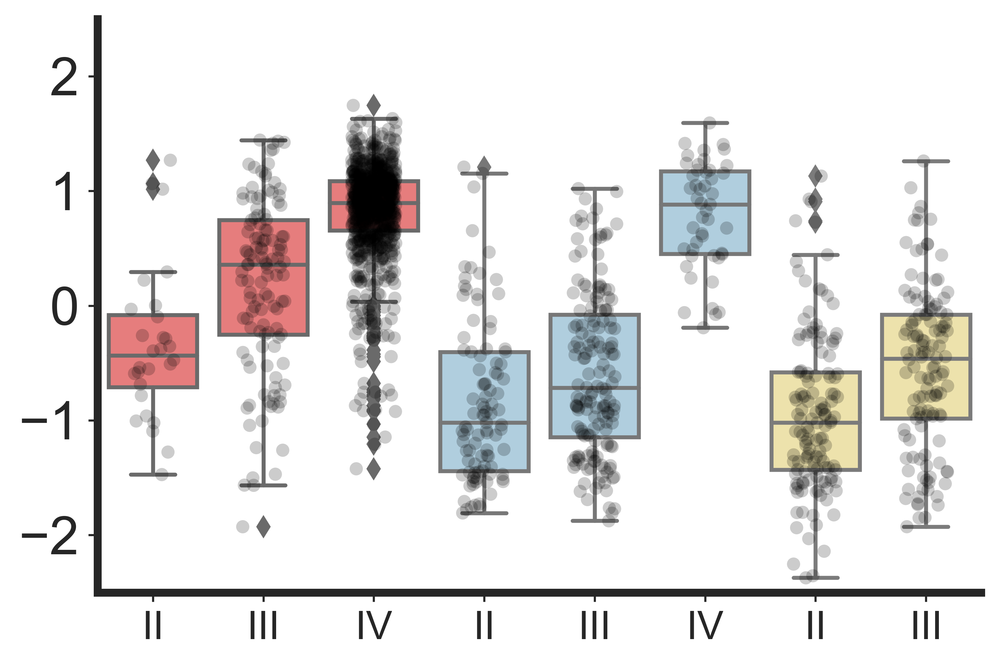

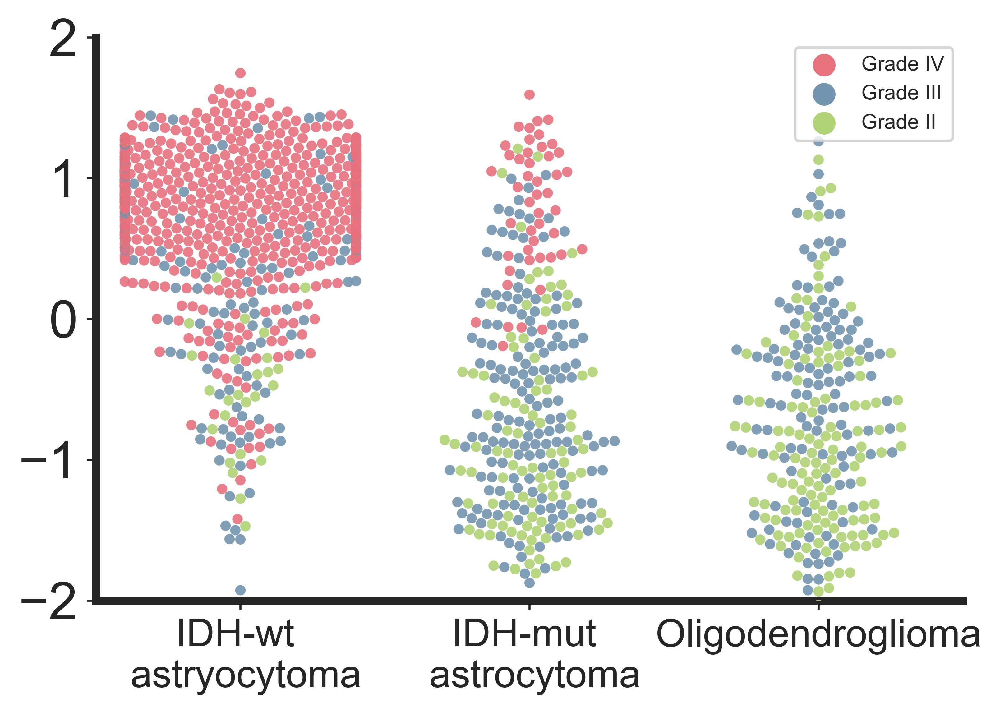

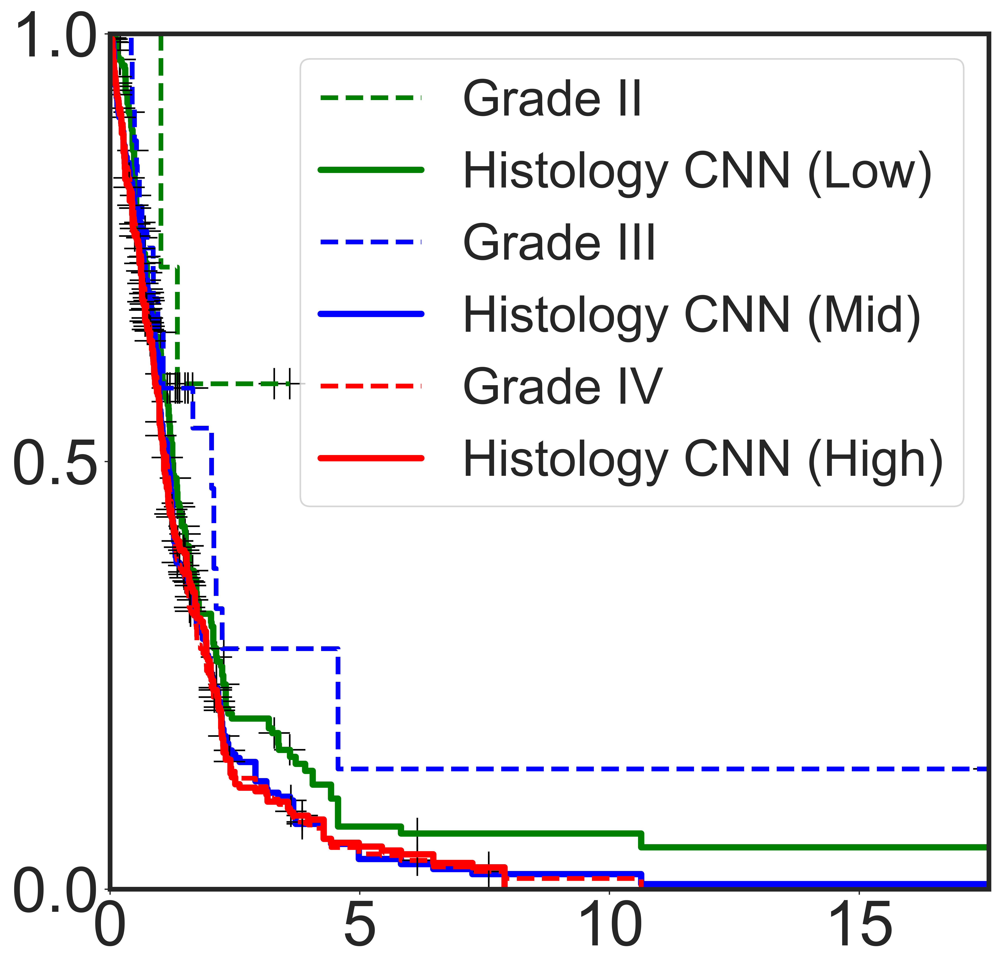

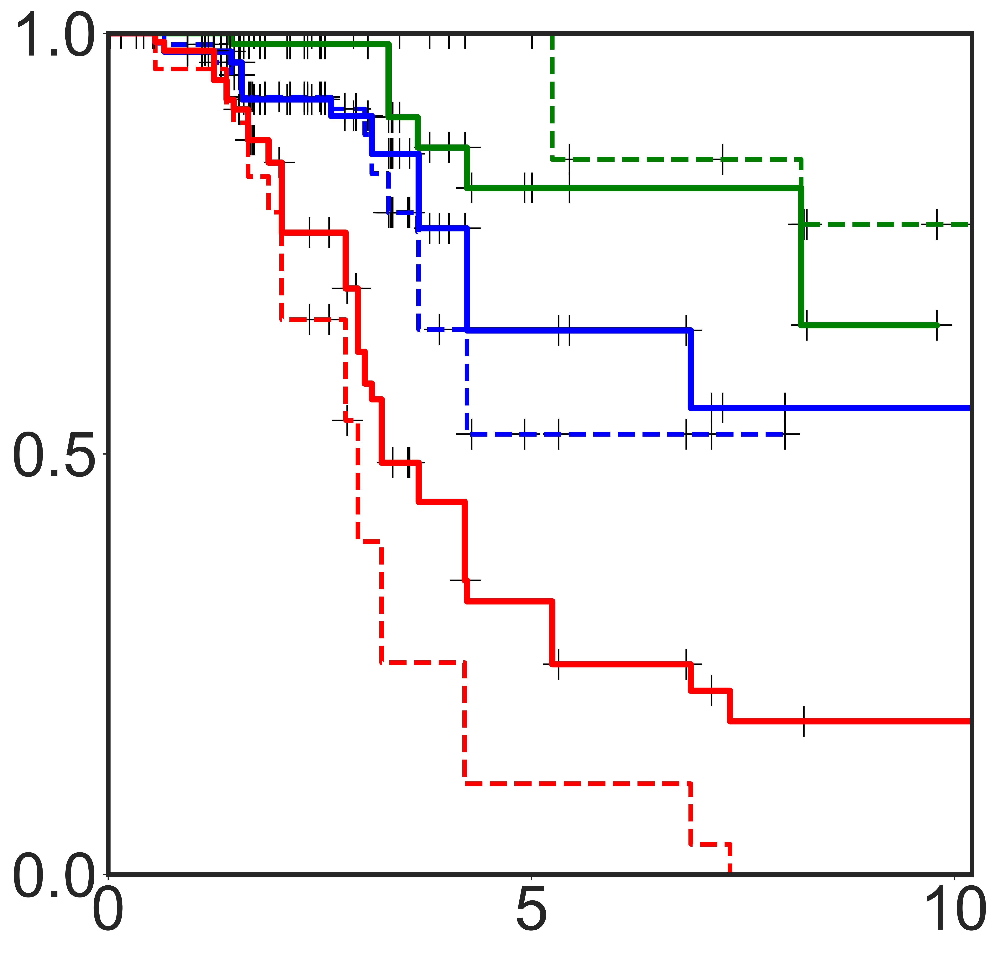

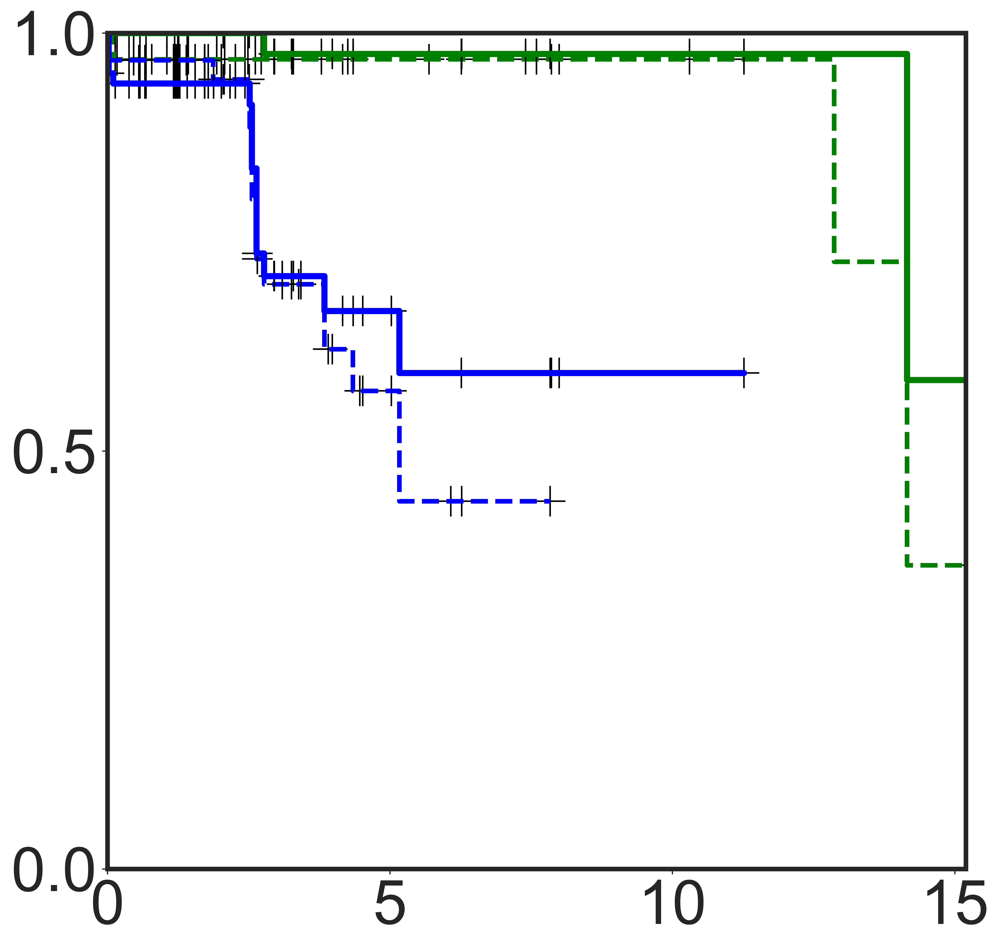

...

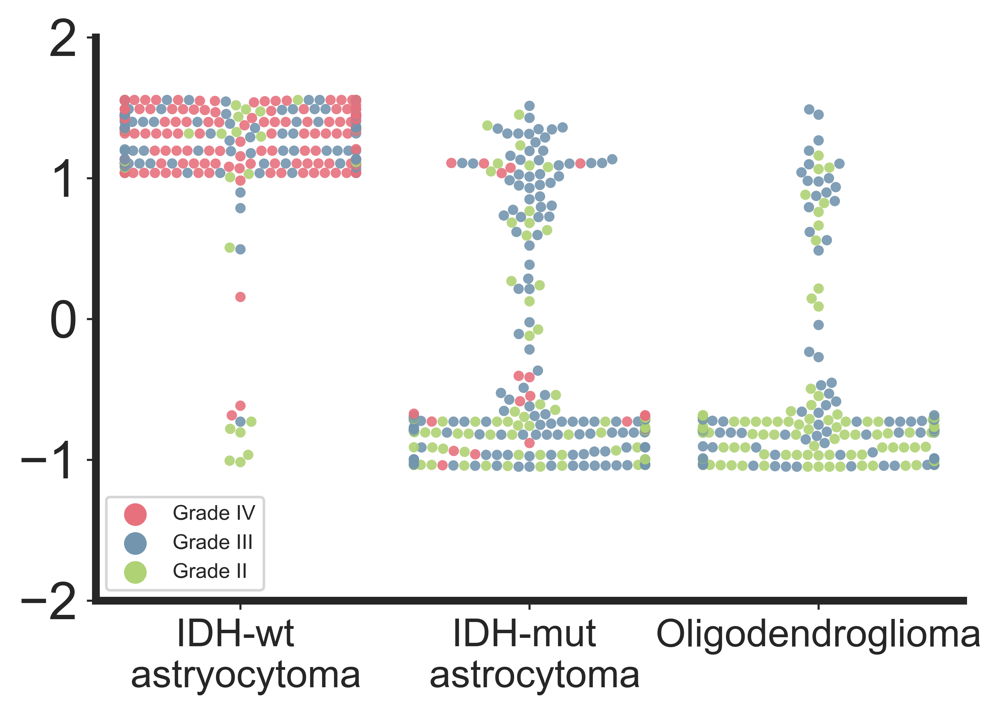

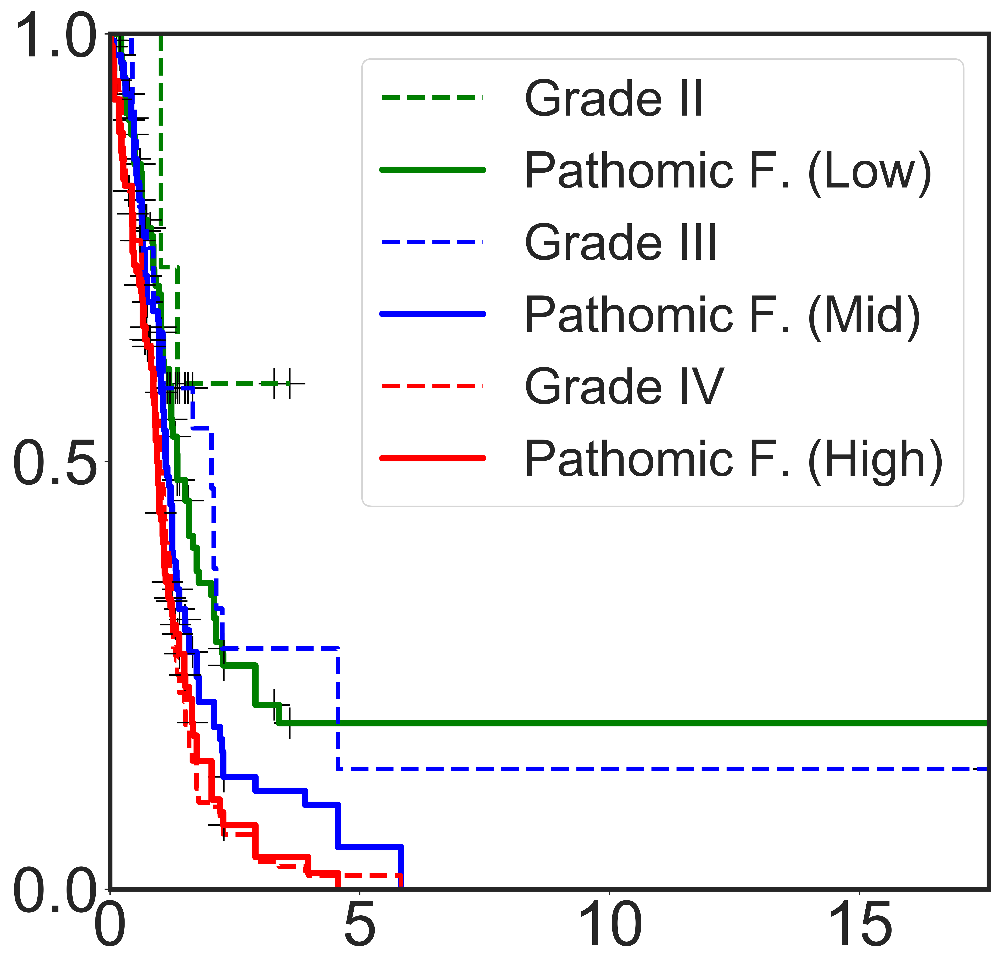

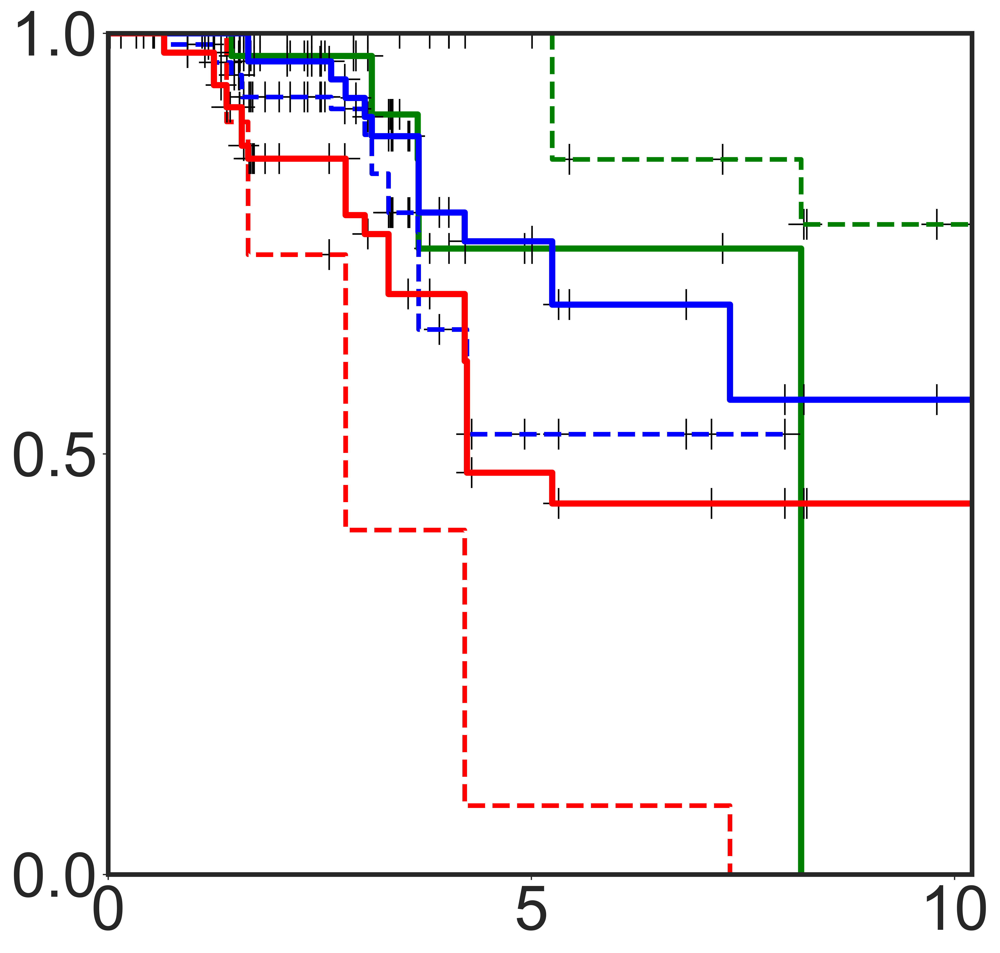

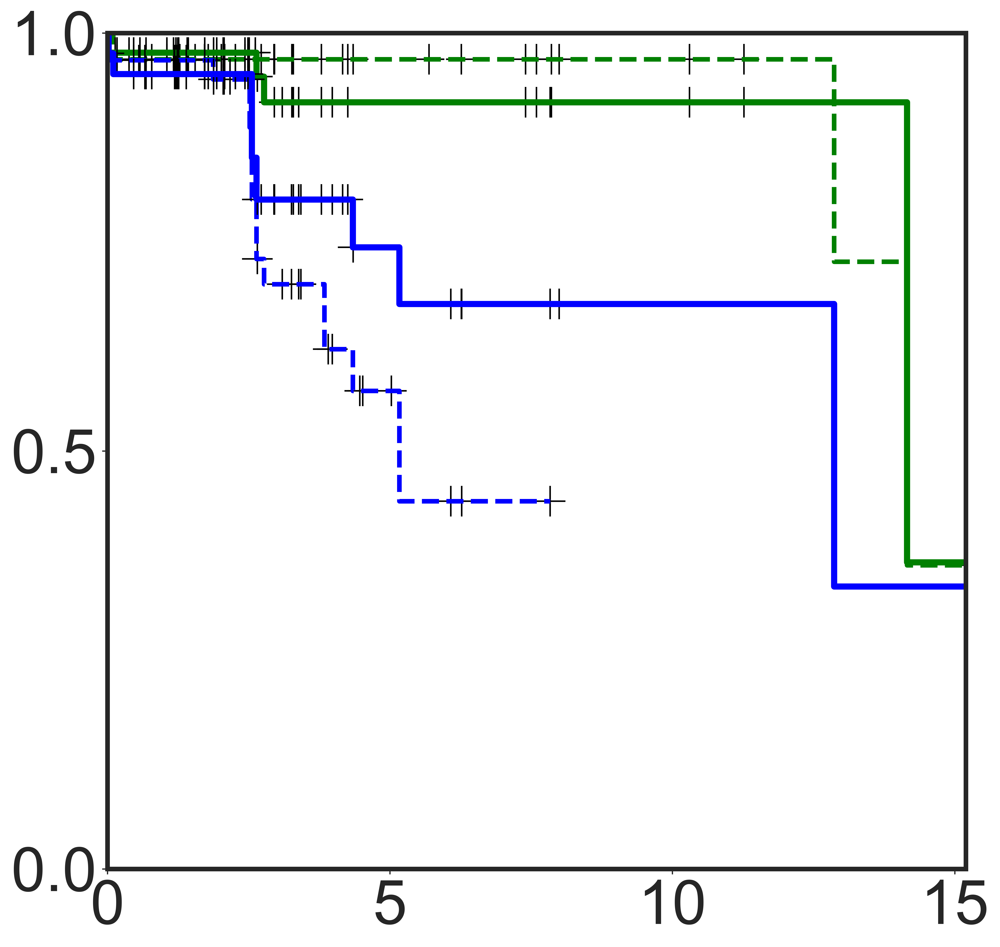

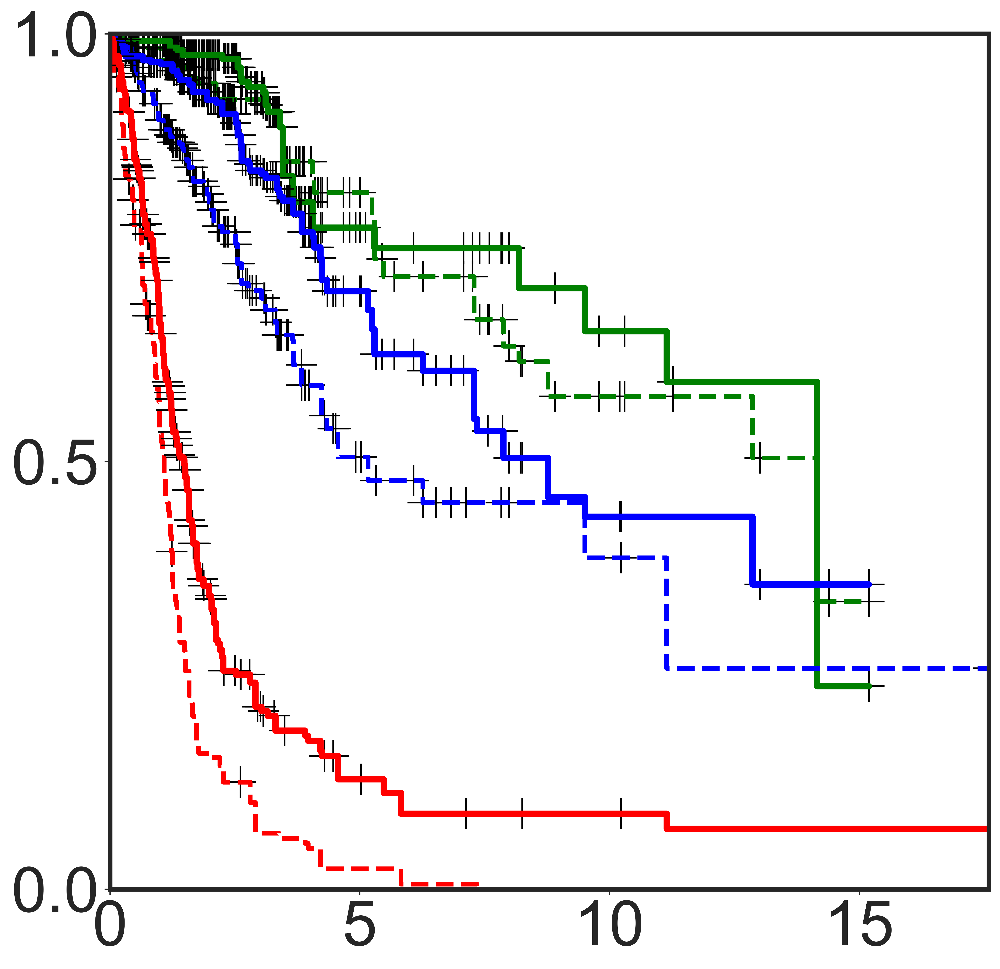

In [15]:
for model in ['path', 'graph', 'omic', 'pathgraphomic_fusion']:
    makeHazardBoxPlot(ckpt_name='./checkpoints/surv_15_rnaseq2/', model=model)
    makeHazardSwarmPlot(ckpt_name='./checkpoints/surv_15_rnaseq2/', model=model)
    makeKaplanMeierPlot(ckpt_name='./checkpoints/surv_15_rnaseq2/', model=model)

Class: 0
	path - AUC: 0.888 ± 0.021
	graph - AUC: 0.832 ± 0.031
	omic - AUC: 0.858 ± 0.032
	pathgraphomic_fusion - AUC: 0.892 ± 0.025
Class: 1
	path - AUC: 0.828 ± 0.023
	graph - AUC: 0.767 ± 0.024
	omic - AUC: 0.709 ± 0.057
	pathgraphomic_fusion - AUC: 0.840 ± 0.028
Class: 2
	path - AUC: 0.971 ± 0.006
	graph - AUC: 0.945 ± 0.011
	omic - AUC: 0.942 ± 0.016
	pathgraphomic_fusion - AUC: 0.988 ± 0.006
Class: micro
	path - AUC: 0.915 ± 0.012
	graph - AUC: 0.872 ± 0.016
	omic - AUC: 0.872 ± 0.019
	pathgraphomic_fusion - AUC: 0.927 ± 0.015


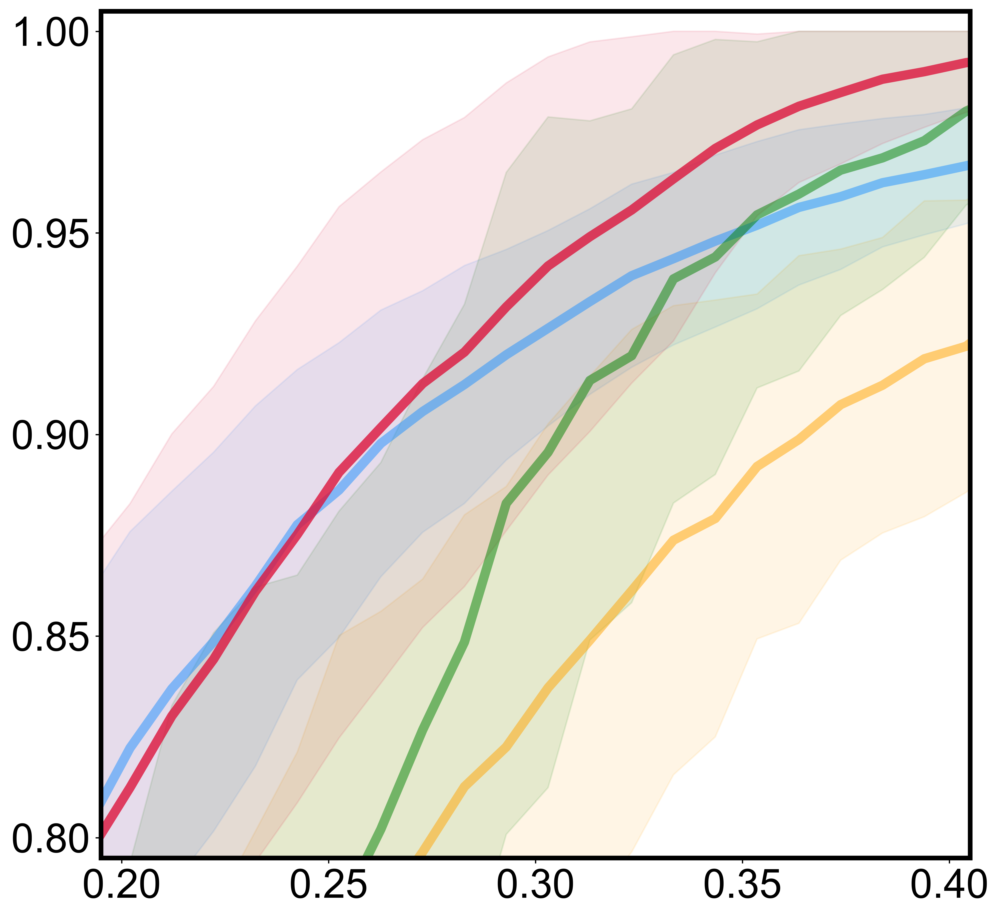

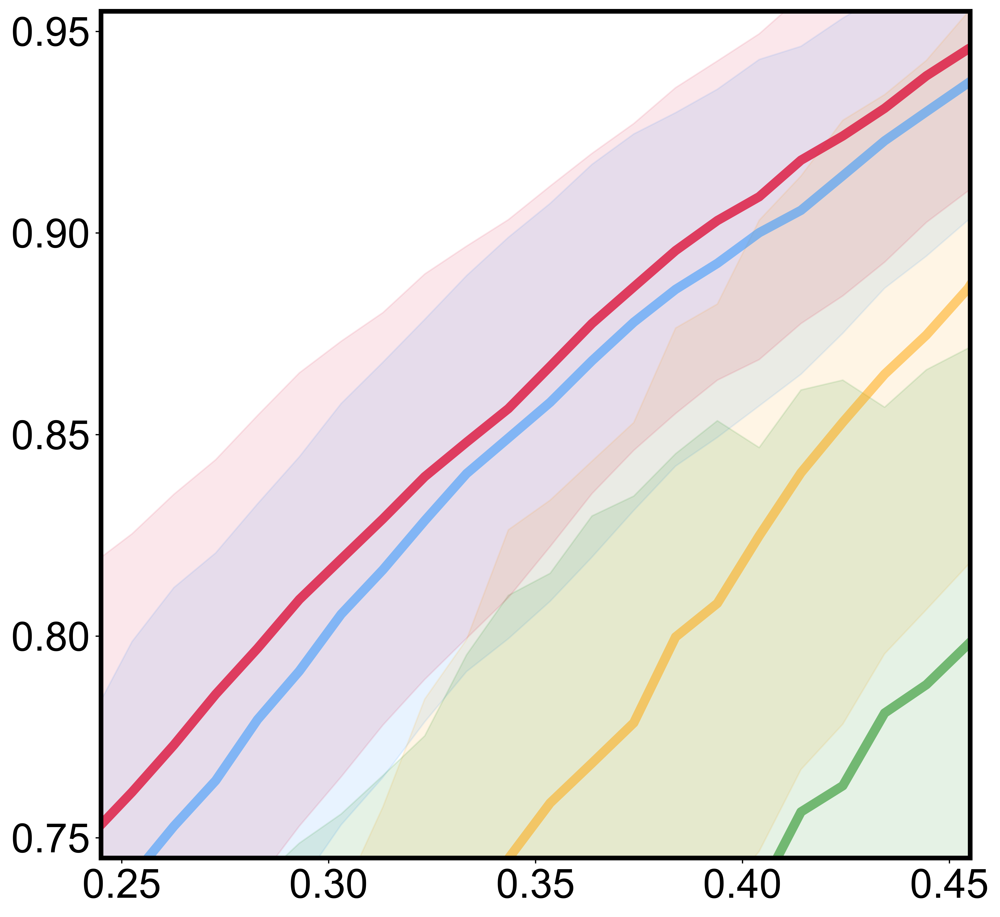

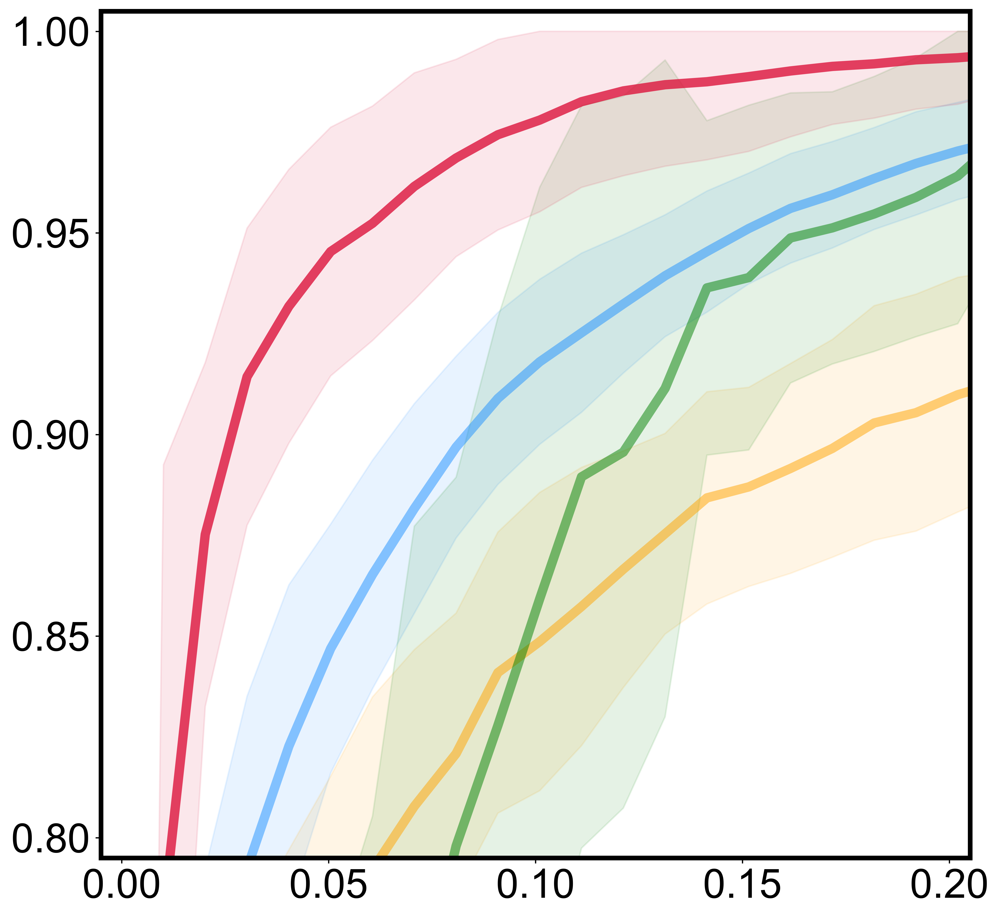

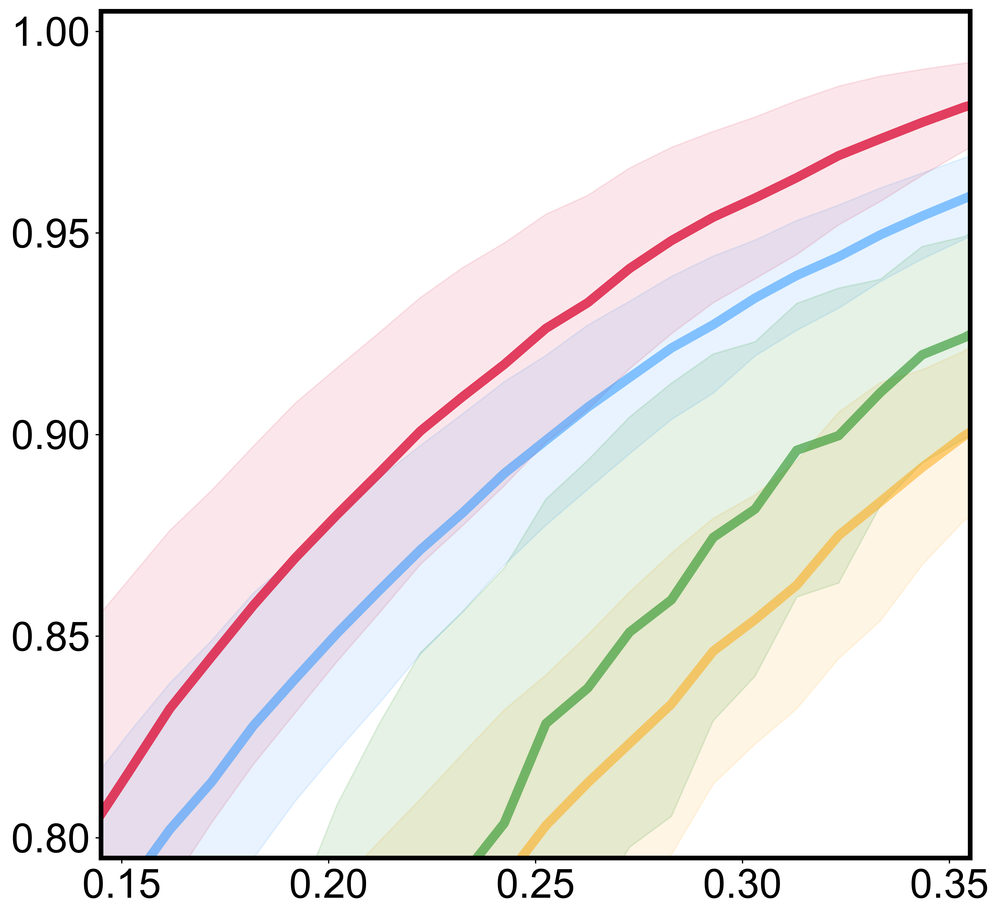

In [6]:
makeAUROCPlot(ckpt_name='./checkpoints/grad_15', model_list=['path', 'graph', 'omic', 'pathgraphomic_fusion'], use_zoom=True)

In [31]:
def makeAUROCPlot2(ckpt_name='./checkpoints/grad_15/', model_list=['path', 'omic', 'pathgraphomic_fusionV2'], split='test', avg='micro', use_zoom=False):
    mpl.rcParams['font.family'] = "arial"
    colors = {'path':'dodgerblue', 'graph':'green', 'omic':'green', 'pathgraphomic_fusionV2':'crimson'}
    names = {'path':'Histology', 'graph':'Graph Only', 'omic':'Genomics', 'pathgraphomic_fusionV2':'Pathomic F.'}
    zoom_params = {0:([0.2, 0.4], [0.8, 1.0]), 
                   1:([0.25, 0.45], [0.75, 0.95]),
                   2:([0.0, 0.2], [0.8, 1.0]),
                   'micro':([0.15, 0.35], [0.8, 1.0])}
    mean_fpr = np.linspace(0, 1, 100)
    classes = [0, 1, 2, avg]
    ### 1. Looping over classes
    for i in classes:
        print("Class: " + str(i))
        fi = pylab.figure(figsize=(10,10), dpi=600, linewidth=0.2)
        axi = plt.subplot()
        
        ### 2. Looping over models
        for m, model in enumerate(model_list):
            ignore_missing_moltype = 1 if 'omic' in model else 0
            ignore_missing_histype = 1 if 'grad' in ckpt_name else 0
            use_patch, roi_dir, use_vgg_features = ('_patch_', 'all_st_patches_512', 1) if (('path' in model) or ('graph' in model)) else ('_', 'all_st', 0)

            ###. 3. Looping over all splits
            tprs, pres, aucrocs, rocaucs, = [], [], [], []
            for k in range(1,16):
                pred = pickle.load(open(ckpt_name+'/%s/%s_%d%spred_%s.pkl' % (model, model, k, use_patch, split), 'rb'))    
                grade_pred, grade = np.array(pred[3]), np.array(pred[4])
                enc = LabelBinarizer()
                enc.fit(grade)
                grade_oh = enc.transform(grade)

                if i != avg:
                    pres.append(average_precision_score(grade_oh[:, i], grade_pred[:, i])) # from https://scikit-learn.org/stable/auto_examples/model_selection/plot_precision_recall.html
                    fpr, tpr, thresh = roc_curve(grade_oh[:,i], grade_pred[:,i], drop_intermediate=False)
                    aucrocs.append(auc(fpr, tpr)) # https://scikit-learn.org/stable/auto_examples/model_selection/plot_roc.html
                    rocaucs.append(roc_auc_score(grade_oh[:,i], grade_pred[:,i])) # https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_auc_score.html#sklearn.metrics.roc_auc_score
                    tprs.append(interp(mean_fpr, fpr, tpr))
                    tprs[-1][0] = 0.0
                else:
                    # A "micro-average": quantifying score on all classes jointly
                    pres.append(average_precision_score(grade_oh, grade_pred, average=avg))
                    fpr, tpr, thresh = roc_curve(grade_oh.ravel(), grade_pred.ravel())
                    aucrocs.append(auc(fpr, tpr))
                    rocaucs.append(roc_auc_score(grade_oh, grade_pred, avg))
                    tprs.append(interp(mean_fpr, fpr, tpr))
                    tprs[-1][0] = 0.0

            mean_tpr = np.mean(tprs, axis=0)
            mean_tpr[-1] = 1.0
            #mean_auc = auc(mean_fpr, mean_tpr)
            mean_auc = np.mean(aucrocs)
            std_auc = np.std(aucrocs)
            print('\t'+'%s - AUC: %0.3f ± %0.3f' % (model, mean_auc, std_auc))
            
            if use_zoom:
                alpha, lw = (0.8, 6) if model =='pathgraphomic_fusion' else (0.5, 6)
                plt.plot(mean_fpr, mean_tpr, color=colors[model],
                     label=r'%s (AUC = %0.3f $\pm$ %0.3f)' % (names[model], mean_auc, std_auc), lw=lw, alpha=alpha)
                std_tpr = np.std(tprs, axis=0)
                tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
                tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
                plt.fill_between(mean_fpr, tprs_lower, tprs_upper, color=colors[model], alpha=0.1)
                plt.xlim([zoom_params[i][0][0]-0.005, zoom_params[i][0][1]+0.005])
                plt.ylim([zoom_params[i][1][0]-0.005, zoom_params[i][1][1]+0.005])
                axi.set_xticks(np.arange(zoom_params[i][0][0], zoom_params[i][0][1]+0.001, 0.05))
                axi.set_yticks(np.arange(zoom_params[i][1][0], zoom_params[i][1][1]+0.001, 0.05))
                axi.tick_params(axis='both', which='major', labelsize=26)
            else:
                alpha, lw = (0.8, 4) if model =='pathgraphomic_fusion' else (0.5, 3)
                plt.plot(mean_fpr, mean_tpr, color=colors[model],
                     label=r'%s (AUC = %0.3f $\pm$ %0.3f)' % (names[model], mean_auc, std_auc), lw=lw, alpha=alpha)
                std_tpr = np.std(tprs, axis=0)
                tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
                tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
                plt.fill_between(mean_fpr, tprs_lower, tprs_upper, color=colors[model], alpha=0.1)
                plt.xlim([-0.05, 1.05])
                plt.ylim([-0.05, 1.05])
                axi.set_xticks(np.arange(0, 1.001, 0.2))
                axi.set_yticks(np.arange(0, 1.001, 0.2))
                axi.legend(loc="lower right", prop={'size': 20})
                axi.tick_params(axis='both', which='major', labelsize=30)
                #plt.plot([0, 1], [0, 1], linestyle='--', lw=2, color='navy', alpha=.8)

    figures = [manager.canvas.figure
               for manager in matplotlib._pylab_helpers.Gcf.get_all_fig_managers()]
    
    zoom = '_zoom' if use_zoom else ''
    for i, fig in enumerate(figures):
        fig.savefig(ckpt_name+'/AUC_%s%s.png' % (classes[i], zoom))



In [12]:
def makeKaplanMeierPlot_Digital(ckpt_name='./checkpoints/surv_15_single/', model='omic', split='test', zscore=False, agg_type='Hazard_mean'):
    def hazard2KMCurve(data, subtype):
        p = np.percentile(data['Hazard'], [33, 66])
        if p[0] == 3.0: p[0] = 2.9999
        data.insert(0, 'grade_pred', [hazard2grade(hazard, p) for hazard in data['Hazard']])
        kmf_pred = lifelines.KaplanMeierFitter()
        fig = plt.figure(figsize=(10, 10), dpi=600)
        ax = plt.subplot()
        censor_style = {'ms': 20, 'marker': '+'}
        
        def get_name(model):
            mode2name = {'pathgraphomic':'Pathomic F.', 'pathomic':'Pathomic F.', 'graphomic':'Pathomic F.', 'path':'Histology CNN', 'graph':'Histology GCN', 'omic':'Genomic SNN'}
            for mode in mode2name.keys():
                if mode in model: return mode2name[mode]
            return 'N/A'
        
        temp = data[data['grade_pred']==0]
        kmf_pred.fit(temp['Survival months']/365, temp['censored'], label="%s (Low)" % get_name(model))
        kmf_pred.plot(ax=ax, show_censors=True, ci_show=False, c='g', linewidth=4, ls='-', markerfacecolor='black', censor_styles=censor_style)
        temp = data[data['grade_pred']==1]
        kmf_pred.fit(temp['Survival months']/365, temp['censored'], label="%s (Mid)" % get_name(model))
        kmf_pred.plot(ax=ax, show_censors=True, ci_show=False, c='b', linewidth=4, ls='-', censor_styles=censor_style)
        temp = data[data['grade_pred']==2]
        kmf_pred.fit(temp['Survival months']/365, temp['censored'], label="%s (High)" % get_name(model))
        kmf_pred.plot(ax=ax, show_censors=True, ci_show=False, c='r', linewidth=4, ls='-', censor_styles=censor_style)

        ax.set_xlabel('')
        ax.set_ylim(0, 1)
        ax.set_yticks(np.arange(0, 1.001, 0.5))
        ax.tick_params(axis='both', which='major', labelsize=40)    
        plt.legend(fontsize=24, prop=font_manager.FontProperties(family='Arial', style='normal', size=24))
        #ax.get_legend().remove()
        return fig
    
    data = poolSurvTestPD(ckpt_name, model, split,  zscore, agg_type)
    fig = hazard2KMCurve(data, 'all')
    fig.savefig(ckpt_name+'/%s_KM_%s_Digital.png' % (model, 'all'))
    
def makeKaplanMeierPlot_Grade(ckpt_name='./checkpoints/surv_15_single/', model='omic', split='test', zscore=False, agg_type='Hazard_mean'):
    def hazard2KMCurve(data, subtype):
        kmf_gt = lifelines.KaplanMeierFitter()
        fig = plt.figure(figsize=(10, 10), dpi=600)
        ax = plt.subplot()
        censor_style = {'ms': 20, 'marker': '+'}
        
        temp = data[data['Grade']==0]
        kmf_gt.fit(temp['Survival months']/365, temp['censored'], label="Grade II")
        kmf_gt.plot(ax=ax, show_censors=True, ci_show=False, c='g', linewidth=3, ls='-', markerfacecolor='black', censor_styles=censor_style)
        temp = data[data['Grade']==1]
        kmf_gt.fit(temp['Survival months']/365, temp['censored'], label="Grade III")
        kmf_gt.plot(ax=ax, show_censors=True, ci_show=False, c='b', linewidth=3, ls='-', censor_styles=censor_style)
        temp = data[data['Grade']==2]
        kmf_gt.fit(temp['Survival months']/365, temp['censored'], label="Grade IV")
        kmf_gt.plot(ax=ax, show_censors=True, ci_show=False, c='r', linewidth=3, ls='-', censor_styles=censor_style)

        ax.set_xlabel('')
        ax.set_ylim(0, 1)
        ax.set_yticks(np.arange(0, 1.001, 0.5))
        ax.tick_params(axis='both', which='major', labelsize=40)    
        plt.legend(fontsize=24, prop=font_manager.FontProperties(family='Arial', style='normal', size=24))
        #ax.get_legend().remove()
        return fig
    
    data = poolSurvTestPD(ckpt_name, model, split,  zscore, agg_type)
    fig = hazard2KMCurve(data, 'all')
    fig.savefig(ckpt_name+'/%s_KM_%s_Grade.png' % ('GradeGT', 'all'))
    
def makeKaplanMeierPlot_Subtype(ckpt_name='./checkpoints/surv_15_single/', model='omic', split='test', zscore=False, agg_type='Hazard_mean'):
    def hazard2KMCurve(data, subtype):
        kmf_gt = lifelines.KaplanMeierFitter()
        fig = plt.figure(figsize=(10, 10), dpi=600)
        ax = plt.subplot()
        censor_style = {'ms': 20, 'marker': '+'}
        
        temp = data[data['Histomolecular subtype']=='ODG']
        kmf_gt.fit(temp['Survival months']/365, temp['censored'], label="ODG")
        kmf_gt.plot(ax=ax, show_censors=True, ci_show=False, c='g', linewidth=3, ls='-', markerfacecolor='black', censor_styles=censor_style)
        temp = data[data['Histomolecular subtype']=='idhmut_ATC']
        kmf_gt.fit(temp['Survival months']/365, temp['censored'], label="IDHmut ATC")
        kmf_gt.plot(ax=ax, show_censors=True, ci_show=False, c='b', linewidth=3, ls='-', censor_styles=censor_style)
        temp = data[data['Histomolecular subtype']=='idhwt_ATC']
        kmf_gt.fit(temp['Survival months']/365, temp['censored'], label="IDHwt ATC")
        kmf_gt.plot(ax=ax, show_censors=True, ci_show=False, c='r', linewidth=3, ls='-', censor_styles=censor_style)

        ax.set_xlabel('')
        ax.set_ylim(0, 1)
        ax.set_yticks(np.arange(0, 1.001, 0.5))
        ax.tick_params(axis='both', which='major', labelsize=40)    
        plt.legend(fontsize=24, prop=font_manager.FontProperties(family='Arial', style='normal', size=24))
        #ax.get_legend().remove()
        return fig
    
    data = poolSurvTestPD(ckpt_name, model, split,  zscore, agg_type)
    fig = hazard2KMCurve(data, 'all')
    fig.savefig(ckpt_name+'/%s_KM_%s_Subtype.png' % ('SubtypeGT', 'all'))

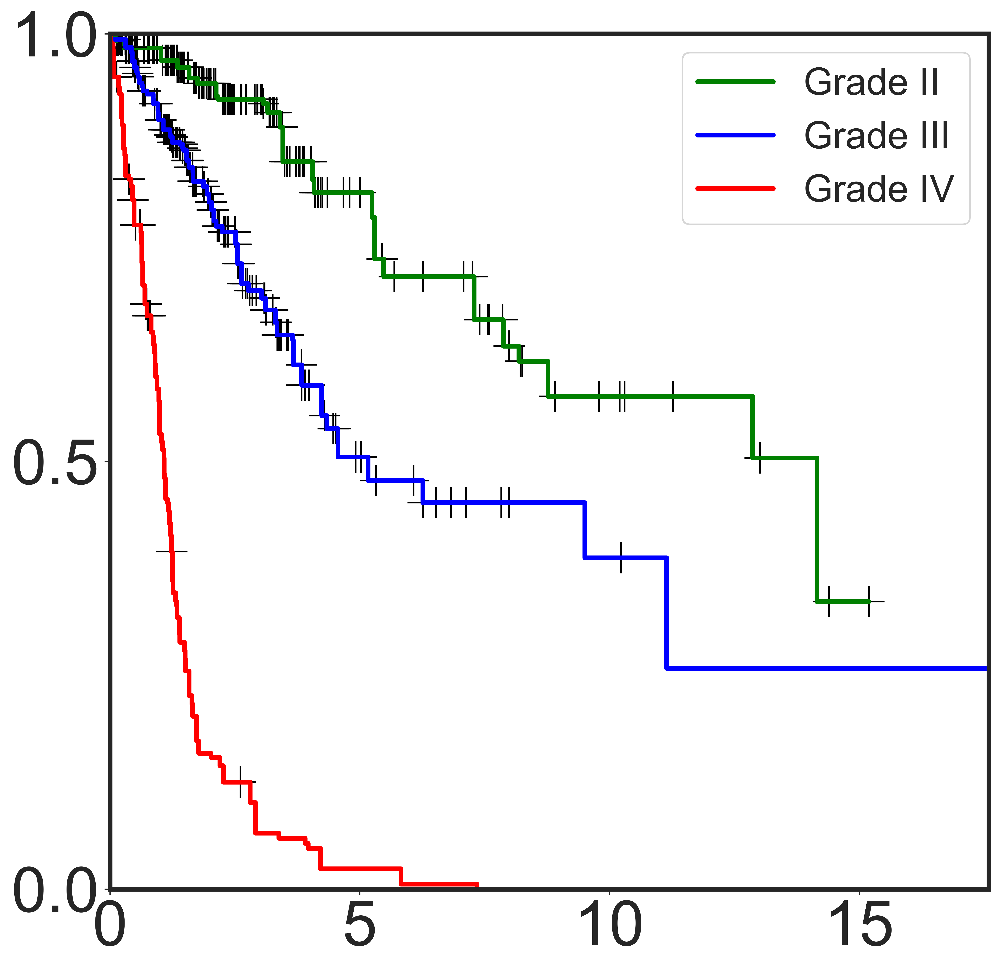

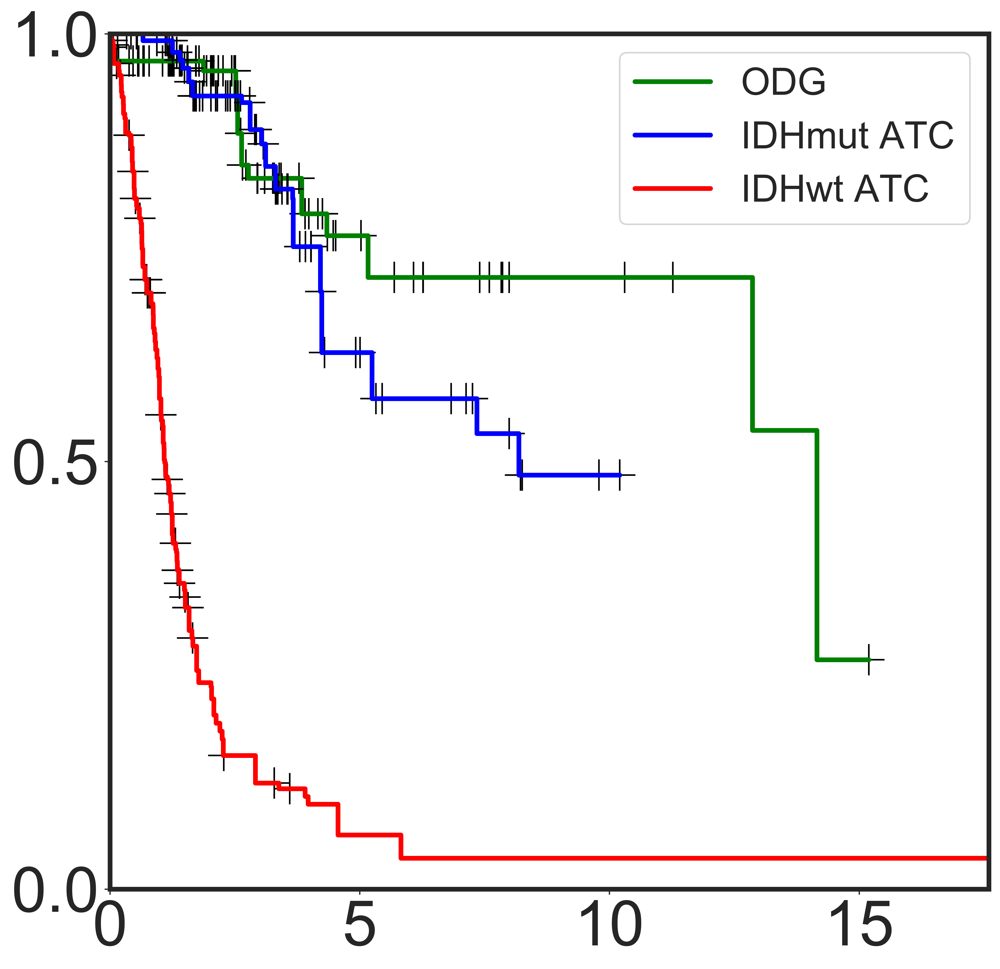

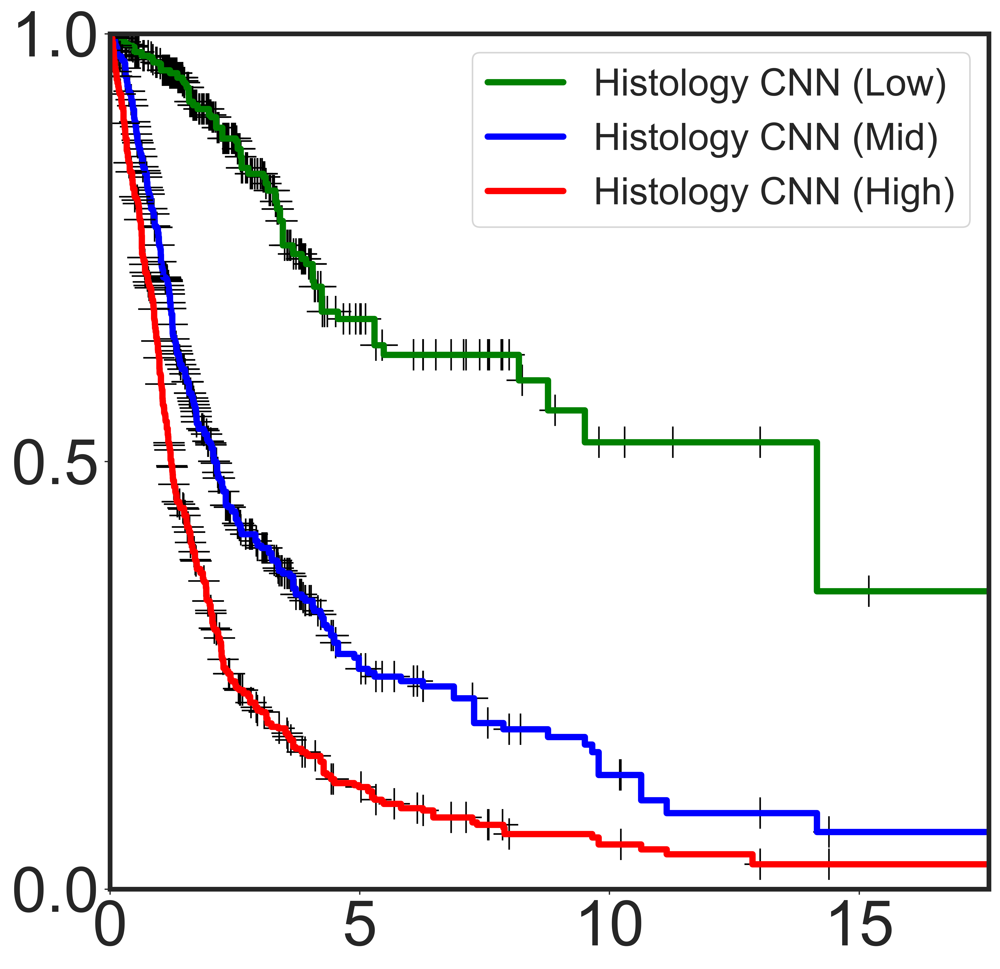

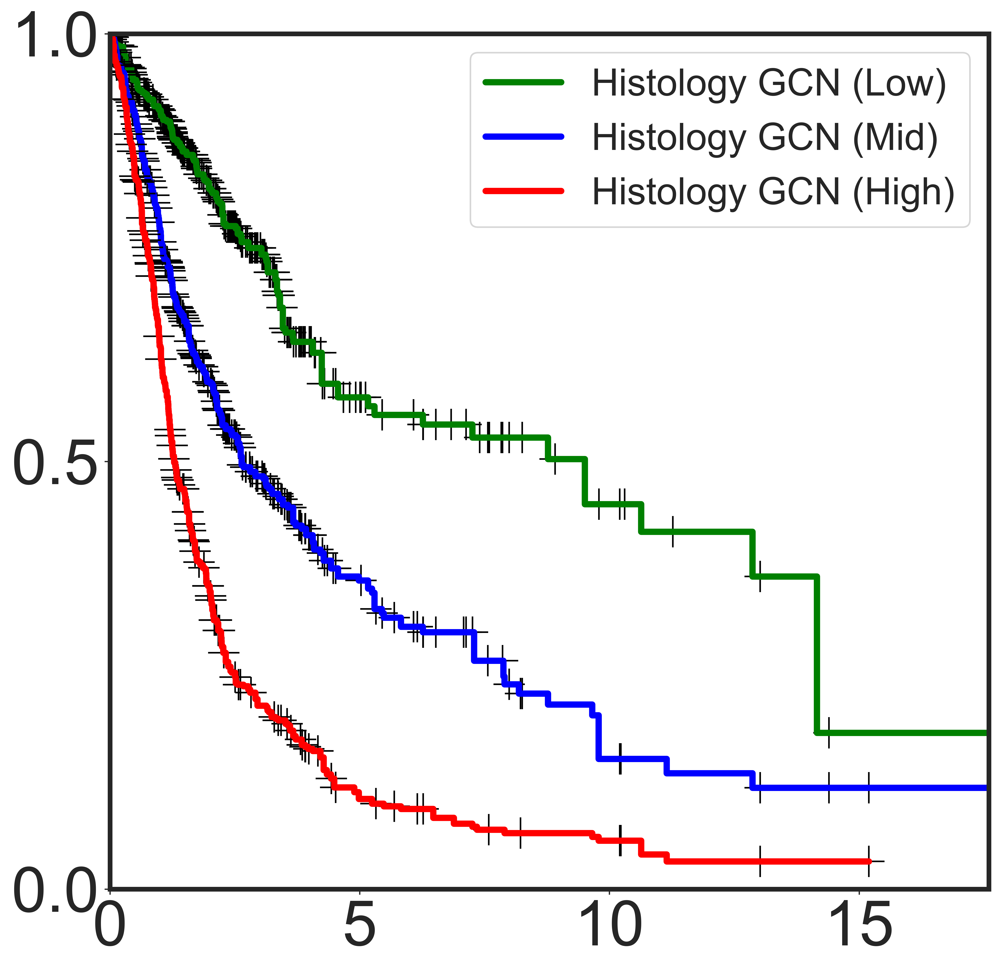

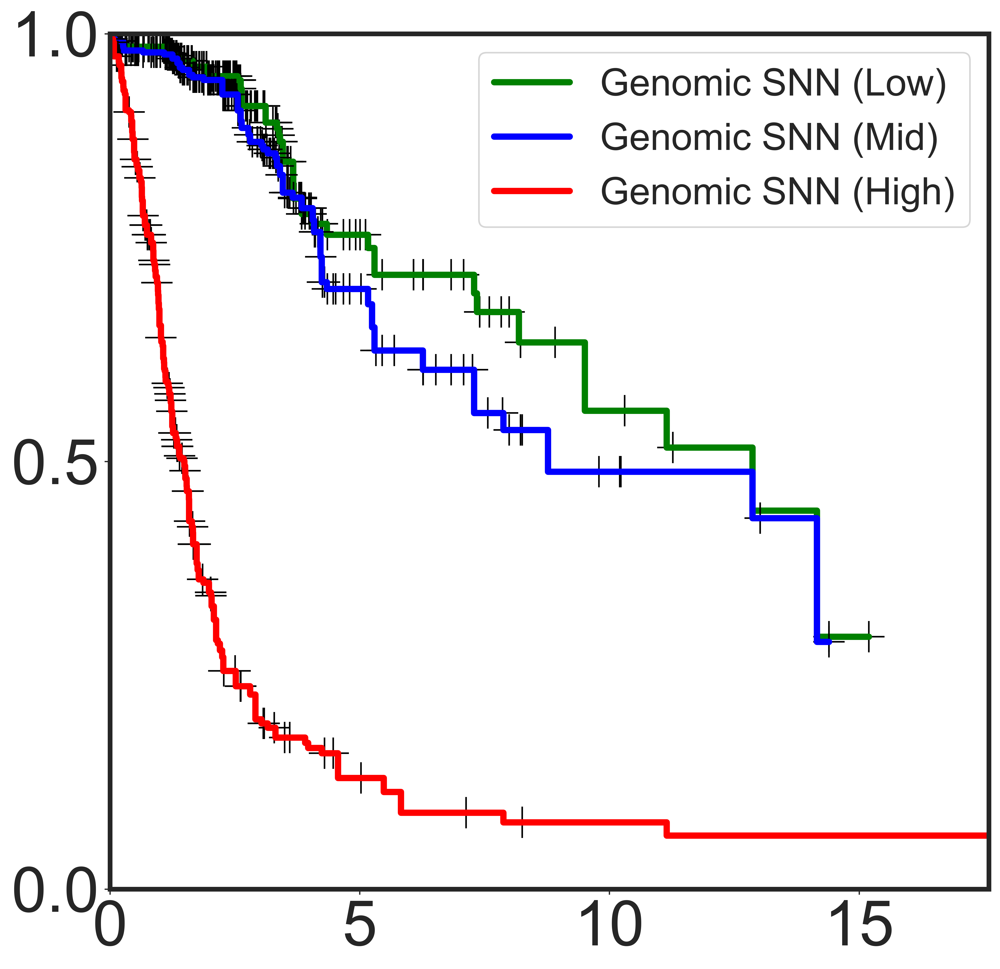

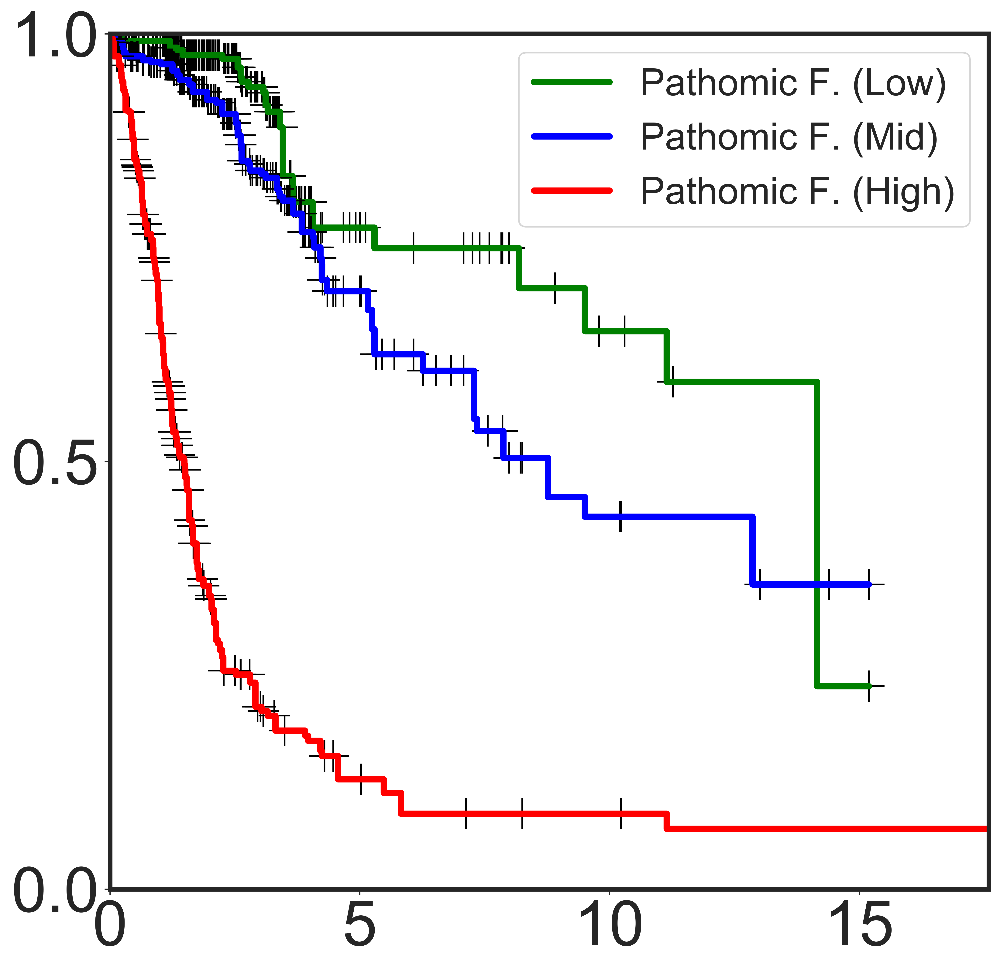

In [16]:
makeKaplanMeierPlot_Grade(ckpt_name='./checkpoints/surv_15_rnaseq2/', model='omic')
makeKaplanMeierPlot_Subtype(ckpt_name='./checkpoints/surv_15_rnaseq2/', model='omic')
    
for model in ['path', 'graph', 'omic', 'pathgraphomic_fusionV2']:
    makeKaplanMeierPlot_Digital(ckpt_name='./checkpoints/surv_15_rnaseq2/', model=model)